In [1]:
import numpy  as np
import pandas as pd
import tables as tb
import matplotlib.pyplot as plt

from ic_course_utils import replace_tag
from ic_course_utils import create_hits_animation
from ic_course_utils import plot_hits_voxelized

%matplotlib inline

In [2]:
input_file = "data/HEe_fastsim.sophronia.h5"
#input_file = "data/HEe_fullsim.sophronia.h5"

# Input file structure

The input file contains a table at `/RECO/Events` that holds a hit collection for each event.
Each row contains a single hit.

The table contains the following columns:
- event: event number
- time: timestamp of the event in s
- npeak: index of the S2 peak within the event
- Xpeak: global X position of the S2 peak
- Ypeak: global Y position of the S2 peak
- nsipm: number of sipms with signal (always 1, will be dropped in the future)
- X, Y: x-y position of the SiPM
- Xrms, Yrms: always NaN (will be dropped in the future)
- Z: drift distance in mm
- Q: SiPM charge in pes
- E: corresponding fraction of the slice energy calculated as $\frac{Q_i}{\sum Q_i}$ 
- Q: corrected SiPM charge (deprecated, may be removed in the future)
- E: corrected hit energy
- track_id: deprecated (will be removed in the future)
- Ep: deprecated (will be removed in the future)

In [3]:
!ptdump -v $input_file:/RECO/Events

/RECO/Events (Table(3182,)shuffle, zlib(4)) 'Hits'
  description := {
  "event": Int64Col(shape=(), dflt=0, pos=0),
  "time": Float64Col(shape=(), dflt=0.0, pos=1),
  "npeak": UInt16Col(shape=(), dflt=0, pos=2),
  "Xpeak": Float64Col(shape=(), dflt=0.0, pos=3),
  "Ypeak": Float64Col(shape=(), dflt=0.0, pos=4),
  "nsipm": UInt16Col(shape=(), dflt=0, pos=5),
  "X": Float64Col(shape=(), dflt=0.0, pos=6),
  "Y": Float64Col(shape=(), dflt=0.0, pos=7),
  "Xrms": Float64Col(shape=(), dflt=0.0, pos=8),
  "Yrms": Float64Col(shape=(), dflt=0.0, pos=9),
  "Z": Float64Col(shape=(), dflt=0.0, pos=10),
  "Q": Float64Col(shape=(), dflt=0.0, pos=11),
  "E": Float64Col(shape=(), dflt=0.0, pos=12),
  "Qc": Float64Col(shape=(), dflt=0.0, pos=13),
  "Ec": Float64Col(shape=(), dflt=0.0, pos=14),
  "track_id": Int32Col(shape=(), dflt=0, pos=15),
  "Ep": Float64Col(shape=(), dflt=0.0, pos=16)}
  byteorder := 'little'
  chunkshape := (546,)
  autoindex := True
  colindexes := {
    "event": Index(6, mediumshu

# Input file data visualization

hDSTs are read directly as pandas DataFrames:

In [4]:
dst = pd.read_hdf(input_file, "/RECO/Events")
dst

,event,time,npeak,Xpeak,Ypeak,nsipm,X,Y,Xrms,Yrms,Z,Q,E,Qc,Ec,track_id,Ep
0,26,5.348394e+06,0,139.067634,87.195110,1,125.0,85.0,0.0,0.0,91.281375,7.088914,135.941661,-1.0,0.000507,-1,-1.0
1,26,5.348394e+06,0,139.067634,87.195110,1,125.0,95.0,0.0,0.0,91.281375,11.436635,219.316396,-1.0,0.000831,-1,-1.0
2,26,5.348394e+06,0,139.067634,87.195110,1,135.0,75.0,0.0,0.0,91.281375,8.759229,167.972701,-1.0,0.000631,-1,-1.0
3,26,5.348394e+06,0,139.067634,87.195110,1,135.0,85.0,0.0,0.0,91.281375,35.520828,681.170645,-1.0,0.002621,-1,-1.0
4,26,5.348394e+06,0,139.067634,87.195110,1,135.0,95.0,0.0,0.0,91.281375,33.907310,650.228772,-1.0,0.002552,-1,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3177,117,1.812015e+07,0,-3.181583,97.555456,1,5.0,115.0,0.0,0.0,337.576844,8.783311,336.500956,-1.0,0.001332,-1,-1.0
3178,117,1.812015e+07,0,-3.181583,97.555456,1,15.0,95.0,0.0,0.0,337.576844,9.287977,355.835431,-1.0,0.001371,-1,-1.0
3179,117,1.812015e+07,0,-3.181583,97.555456,1,15.0,105.0,0.0,0.0,337.576844,10.526705,403.292821,-1.0,0.001574,-1,-1.0
3180,117,1.812015e+07,0,-3.181583,97.555456,1,15.0,115.0,0.0,0.0,337.576844,6.177336,236.662412,-1.0,0.000936,-1,-1.0


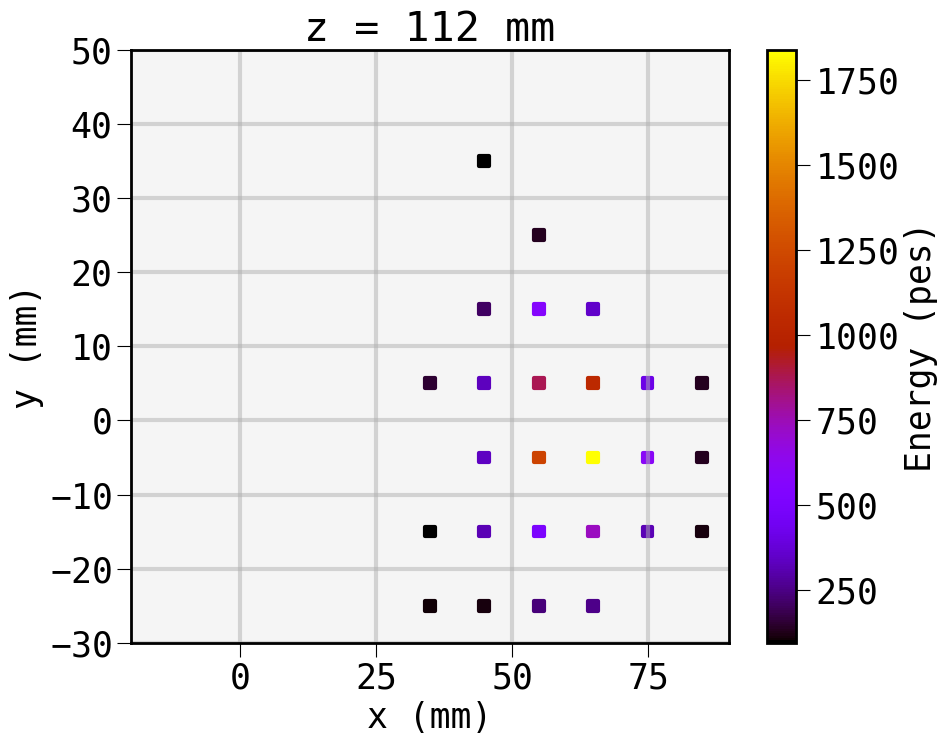

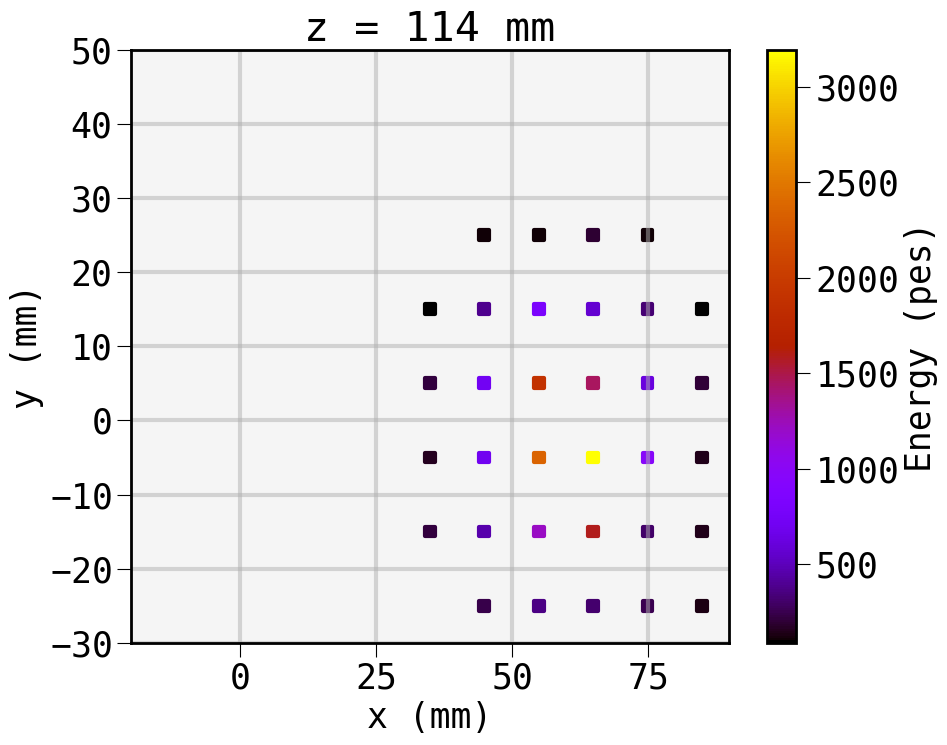

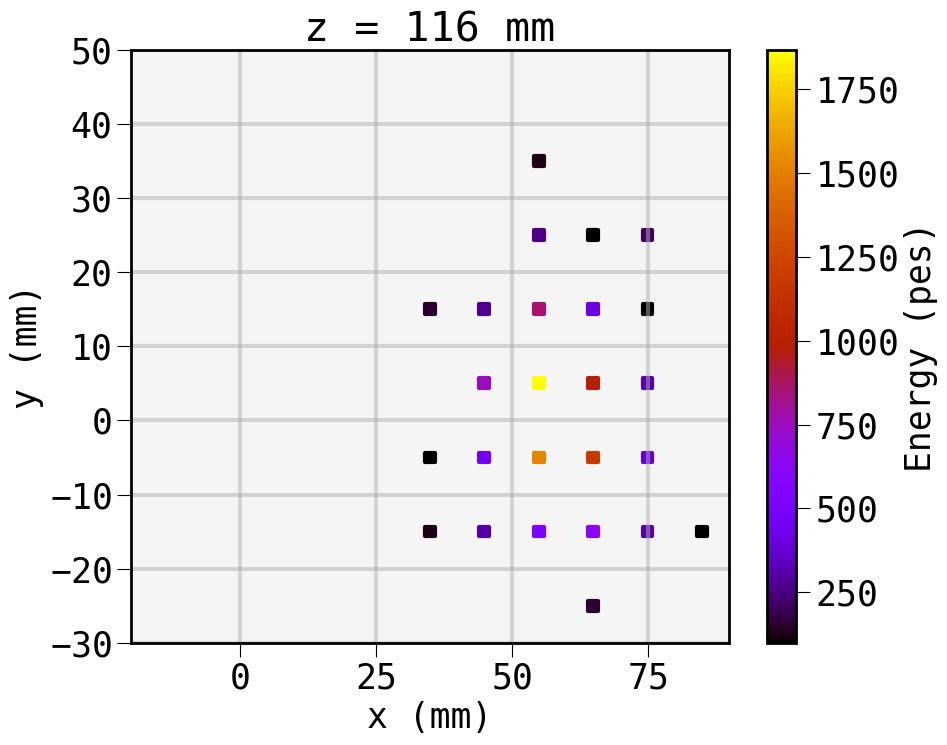

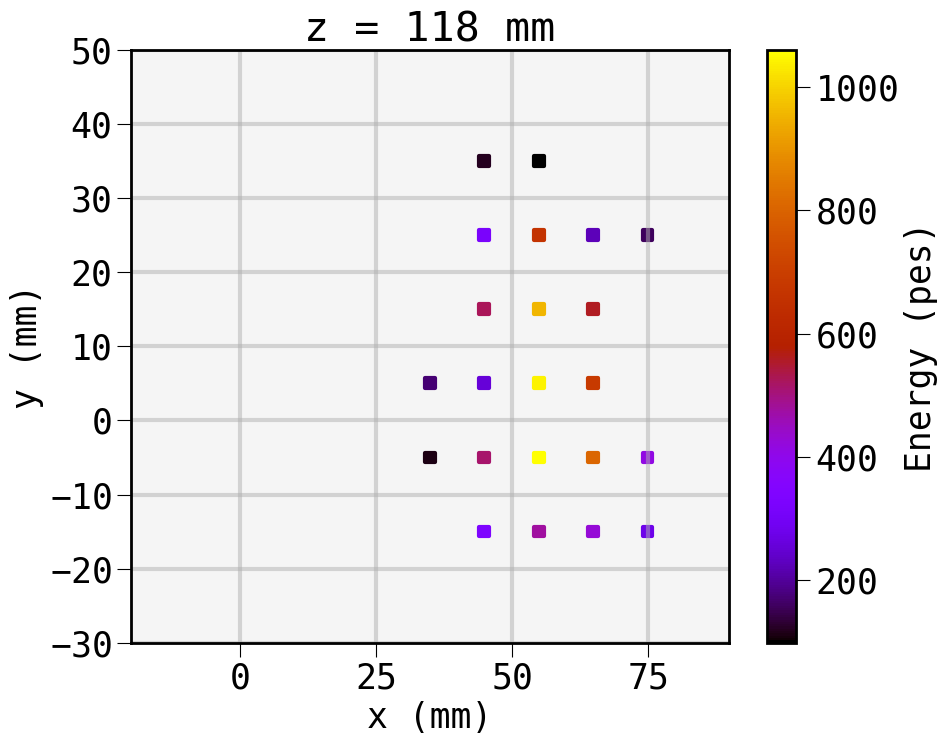

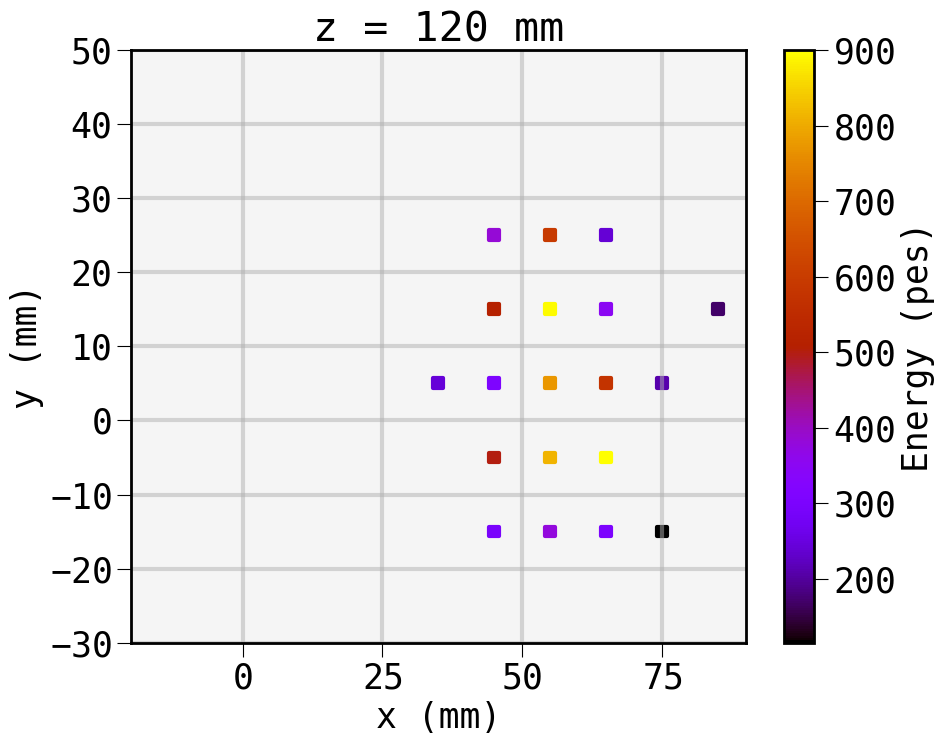

...

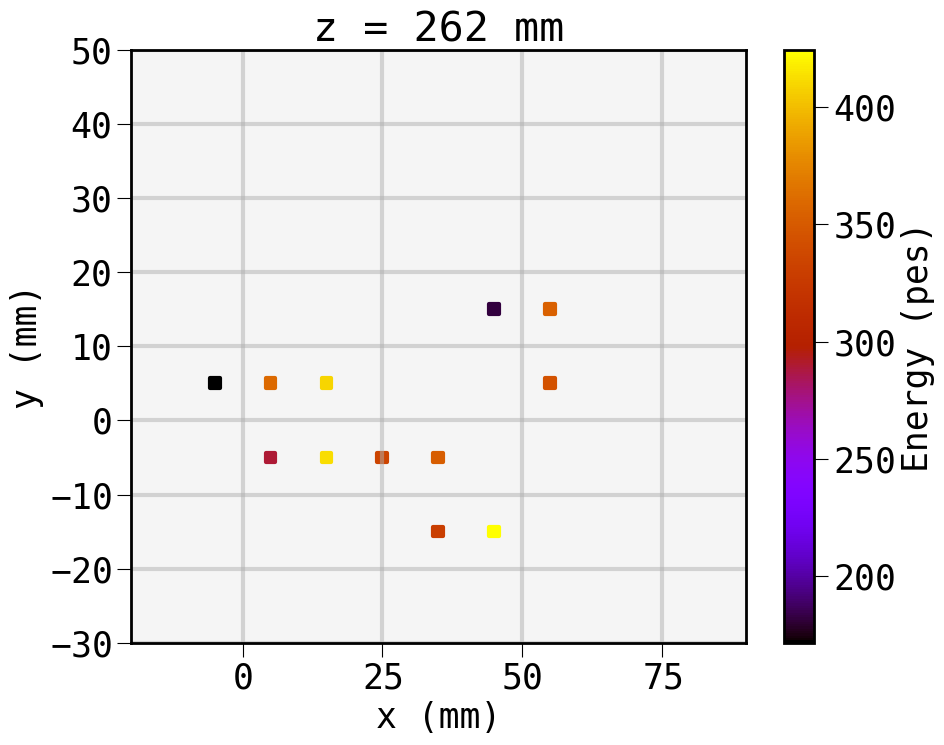

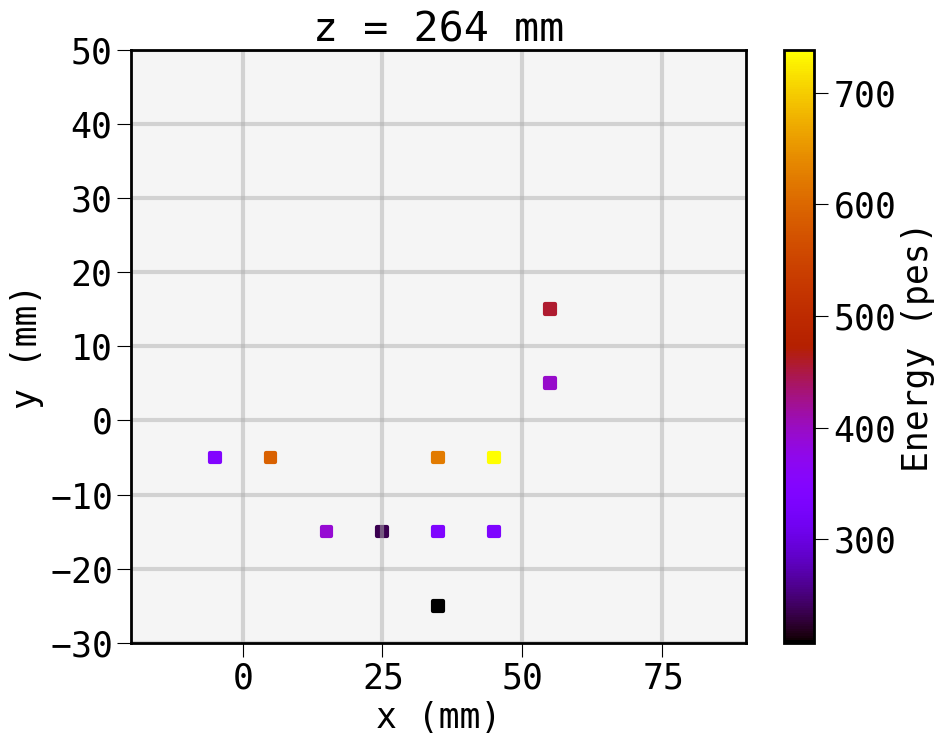

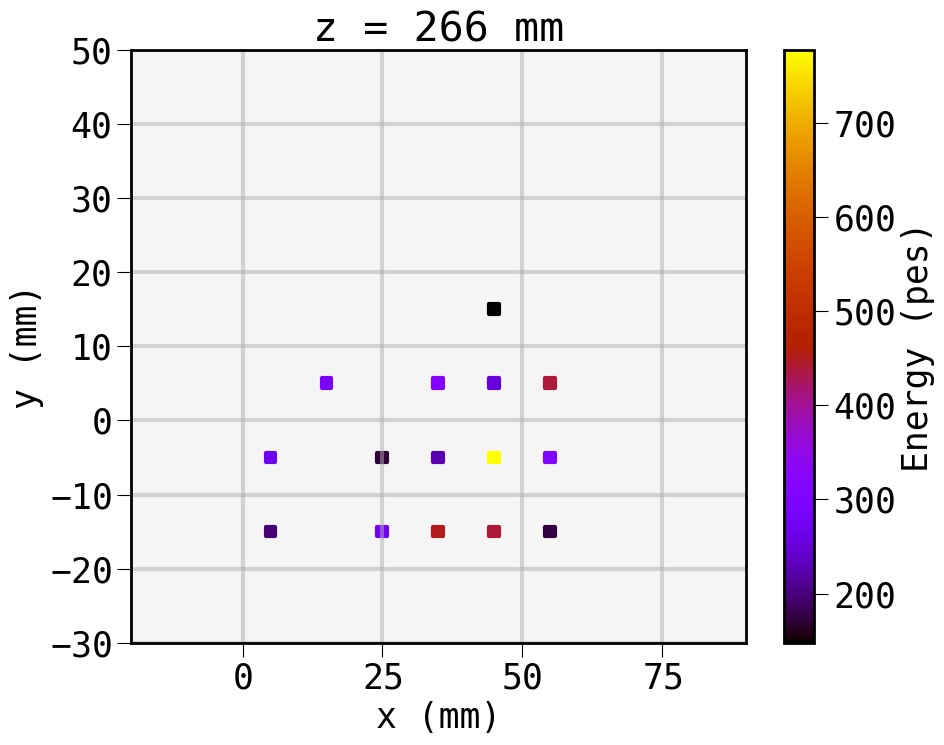

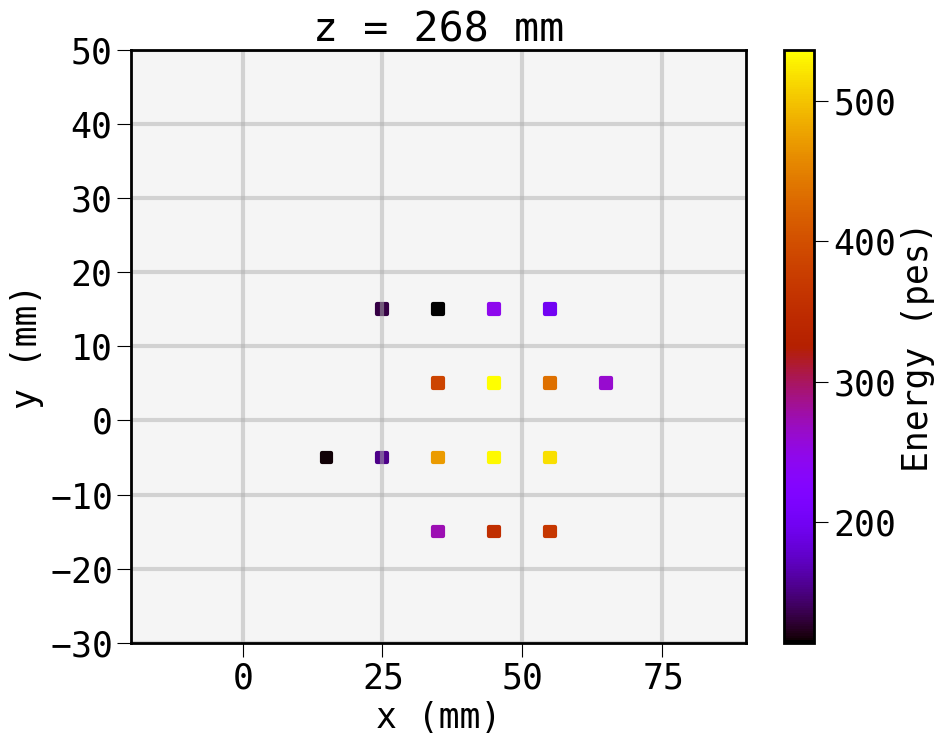

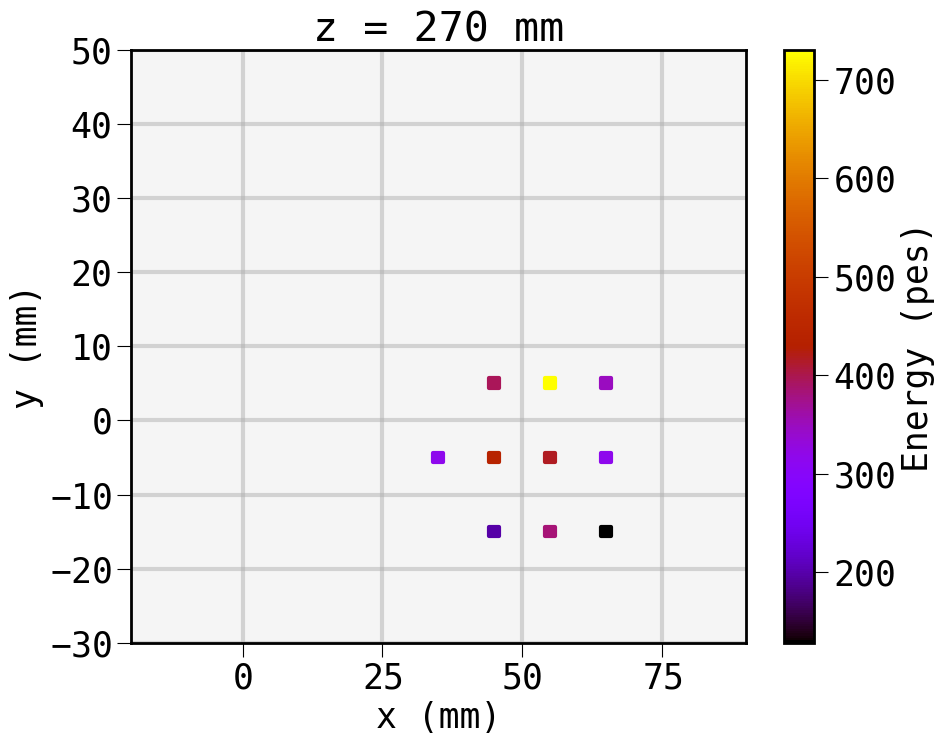

In [5]:
%matplotlib inline 

event = dst.event.unique()[1]
peak  = 0
all_hits  = dst.loc[lambda df: (df.event == event) & (df.npeak == peak)]
for z, hits in all_hits.groupby("Z"):
    if len(hits) <= 3: continue
    plt.figure(figsize=(10,8))
    plt.scatter(hits.X, hits.Y, marker="s", s=50, c=hits.E)
    plt.gca().set_facecolor("whitesmoke")
    plt.xlabel("x (mm)")
    plt.ylabel("y (mm)")
    plt.title(f"z = {z:.0f} mm")
    plt.xlim(all_hits.X.min() - 5, all_hits.X.max() + 5)
    plt.ylim(all_hits.Y.min() - 5, all_hits.Y.max() + 5)
    plt.colorbar().set_label("Energy (pes)")

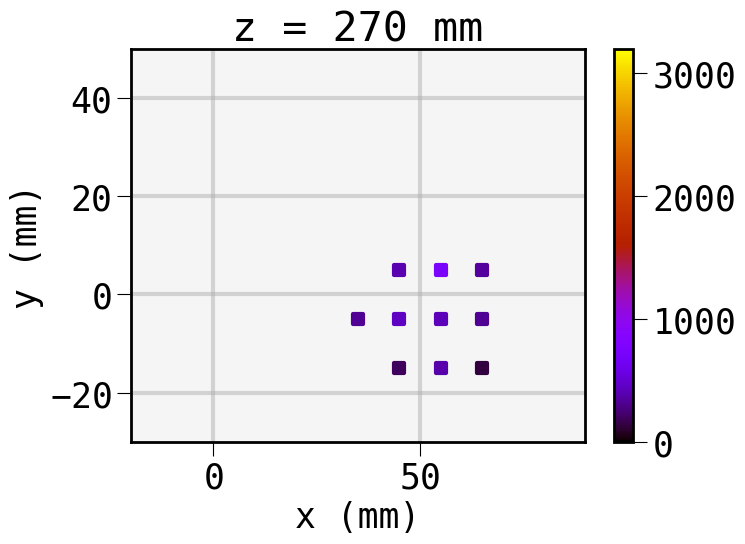

In [6]:
create_hits_animation(all_hits, hitsize=50)

# Beersheba

## Description

Applies Lucy-Rihcardson (LR) reconvolution to reconstruct electron tracks.

This city reads hDSTs produced by Sophronia and produces deconvolved hits. The LR deconvolution finds the (discretized) charge distribution that generates the input image based on the PSF of the system. Each bin in the charge distribution is interpreted as a (deconvolved) hit. The workflow of Beersheba can be summarized as:
- Apply geometrical and lifetime corrections (will be implemented yet in the near future)
- Apply a low charge threshold to the input hits. If this leaves behind a slice with no hits, a fake hit (NN-hit) is temporarily created.
- Merge NN-hits: The NN-hits' energy is reassigned to the closest non-NN-hits
- Apply a second charge threshold with a slightly different energy redistribution
- Drops isolated sensors (\*)
- Normalizes charge within each S2 peak
- For each slice
    - Interpolates the hits to obtain a continuous image (real_image)
    - Generate a flat charge distribution as a seed
    - Do the following until a maximum number of iterations is reached or the difference between consecutive images is smaller than a threshold
        - Convolve the charge distribution with the PSF (new_image)
        - Update the charge distribution according to the difference between new_image and real_image
    - Clean up the image by applying a cut on the fraction of energy of the resulting charge-distribution hits

(\*) This helps to remove artifacts in the reconstruction

More details will be found in the official documentation:
https://next-exp-sw.readthedocs.io/en/latest/beersheba.html
.

## Parameters

| Parameter | Type  | Description |
|:--------:|:--------:|:--------:|
| `threshold` | `float` | Charge threshold applied to the hits |
| `same_peak` | `bool` | Whether to allow the NN hits' energy reassignment to hits in other S2 peaks |
| `deconv_params` | `dict` | Parameters to configure the deconvolution algorithm |
| `corrections_file` | `str` | Filename containing the correction maps (will be implemented in the near future) |
| `apply_temp` | `bool` | Whether to apply temporal corrections (always False for MC)  (will be implemented in the near future) |

Deconvolution params:

| Parameter | Type  | Description |
|:--------:|:--------:|:--------:|
| `q_cut` | `float` | Second charge threshold. |
| `drop_dist` | `(float, float)` | Distance used to consider a SiPM isolated (typically the 1\*pitch)|
| `psf_fname` | `str` | Path to the file holding the PSF (produced by Eutropia) |
| `e_cut` | `float` | Cut value applied on the final image to clean it up. See `cut_type` for interpretation |
| `n_iterations` | `int` | Maximum number of iterations to perform (\*) |
| `iteration_tol` | `float` | Tolerance for the difference between two consecutive images to be considered equal |
| `sample_width` | `(float, float)` | The pitch of the original image (i.e. the SiPM pitch) |
| `bin_size` | `(float, float)` | Bin size of the deconvolved image |
| `energy_type` | `HitEnergy` | Which energy variable to use: uncorrected (E) or correcter (Ec), typically Ec |
| `diffusion` | `(float, float)` | Diffusion coefficients in x,y expressed in mm/sqrt(cm) |
| `deconv_mode` | `DeconvolutionMode` | Whether to apply a z-dependent PSF (joint) or to perform two deconvolutions using a global PSF + an EL PSF. Typically joint |
| `n_dim` | `int` | Number of dimensions on which to perform the deconvolution (2 or 3). 3 dimensions not implemented yet |
| `cut_type` | `CutType` | Whether `e_cut` is applied on the absolute (abs) or relative (rel) hit energy. Usually rel |
| `interp_method` | `int` | Which interpolation method to use for the input image (None, linear, cubic). Typically cubic |

(\*) Performing too many iterations can introduce artifacts on the final image

## Configuration

A Beersheba configuration file for NEW data.

Note that here we don't specify the input and output files in the config file, but you can do so!

In [7]:
config_file = "config_files/beersheba.conf"

In [8]:
!cat $config_file

event_range = all
compression = "ZLIB4"
print_mod   = 1

detector_db = "new"
run_number = -6400

threshold = 6 * pes
same_peak = True

deconv_params   = dict(
  q_cut         = 10,
  drop_dist     = [10., 10.],
  psf_fname     = 'maps/new.psf',
  e_cut         = 1e-3,
  n_iterations  = 10,
  iteration_tol = 0.01,
  sample_width  = [10., 10.],
  bin_size      = [ 1.,  1.],
  energy_type   = Ec,
  diffusion     = (1.0, 1.0),
  deconv_mode   = joint,
  n_dim         = 2,
  cut_type      = abs,
  inter_method  = cubic)

## City execution

In [9]:
output_file = replace_tag(input_file, "sophronia", "beersheba")
output_file

'data/HEe_fastsim.beersheba.h5'

In [10]:
!city beersheba $config_file -i $input_file -o $output_file

NumExpr defaulting to 4 threads.
Using selector: EpollSelector
events processed: 0, event number: 26
events processed: 1, event number: 39
events processed: 2, event number: 65
events processed: 3, event number: 78
events processed: 4, event number: 104
events processed: 5, event number: 117


## Output

- cDST (`CHITS/lowTh`): same as hDST, but contains a corrected-energy field and are associated to tracks. Equivalent to Esmeralda's highTh.
- dDST (`DECO/Events`): a table containing the deconvolved hits
- kDST (`DST/Events`): copied from the input

The dDST table contains the following columns:
- event: event number
- npeak: index of the S2 peak within the event
- X, Y: x-y position of the deconvolved hit (center of the charge distribution bin)
- Z: center of the slice in z
- E: hit energy. Corresponds to E or Ec depending on the configuration
- Xpeak: global X position of the S2 peak
- Ypeak: global Y position of the S2 peak
- time: timestamp of the event in s
- nsipm: meaningless. Will be dropped in the future
- Xrms, Yrms: meaningless. Will be dropped in the future

In [11]:
!ptdump -v $output_file:/DECO/Events

/DECO/Events (Table(120229,)shuffle, zlib(4)) 'Deconvolved hits'
  description := {
  "event": Int32Col(shape=(), dflt=0, pos=0),
  "npeak": Float64Col(shape=(), dflt=0.0, pos=1),
  "X": Float64Col(shape=(), dflt=0.0, pos=2),
  "Y": Float64Col(shape=(), dflt=0.0, pos=3),
  "Z": Float64Col(shape=(), dflt=0.0, pos=4),
  "E": Float64Col(shape=(), dflt=0.0, pos=5),
  "Xpeak": Float64Col(shape=(), dflt=0.0, pos=6),
  "Ypeak": Float64Col(shape=(), dflt=0.0, pos=7),
  "time": Float64Col(shape=(), dflt=0.0, pos=8),
  "nsipm": Int64Col(shape=(), dflt=0, pos=9),
  "Xrms": Int64Col(shape=(), dflt=0, pos=10),
  "Yrms": Int64Col(shape=(), dflt=0, pos=11)}
  byteorder := 'little'
  chunkshape := (712,)
  autoindex := True
  colindexes := {
    "event": Index(6, mediumshuffle, zlib(1)).is_csi=False}


Deconvolved hits are read directly as pandas DataFrames:

In [12]:
dhits = pd.read_hdf(output_file, "/DECO/Events")
dhits

,event,npeak,X,Y,Z,E,Xpeak,Ypeak,time,nsipm,Xrms,Yrms
0,26,0.0,126.5,91.5,91.281375,0.000002,139.067634,87.195110,5.348394e+06,0,0,0
1,26,0.0,126.5,92.5,91.281375,0.000002,139.067634,87.195110,5.348394e+06,0,0,0
2,26,0.0,126.5,93.5,91.281375,0.000002,139.067634,87.195110,5.348394e+06,0,0,0
3,26,0.0,126.5,94.5,91.281375,0.000002,139.067634,87.195110,5.348394e+06,0,0,0
4,26,0.0,126.5,95.5,91.281375,0.000002,139.067634,87.195110,5.348394e+06,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
120224,117,0.0,16.5,105.5,337.576844,0.000011,-3.181583,97.555456,1.812015e+07,0,0,0
120225,117,0.0,16.5,106.5,337.576844,0.000010,-3.181583,97.555456,1.812015e+07,0,0,0
120226,117,0.0,16.5,107.5,337.576844,0.000009,-3.181583,97.555456,1.812015e+07,0,0,0
120227,117,0.0,17.5,104.5,337.576844,0.000009,-3.181583,97.555456,1.812015e+07,0,0,0


## dDST visualization

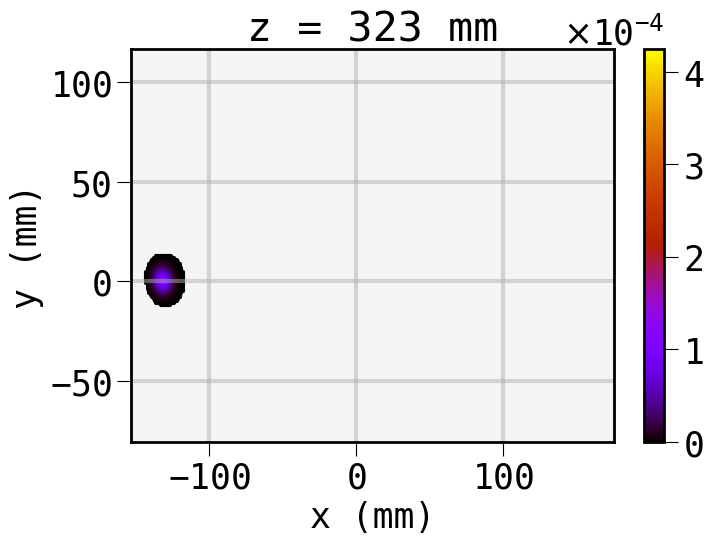

In [13]:
%matplotlib inline
event = dhits.event.unique()[0]
hits  = dhits .loc[lambda df: (df.event == event)]
create_hits_animation(hits, hitsize=1)

<IPython.core.display.Javascript object>


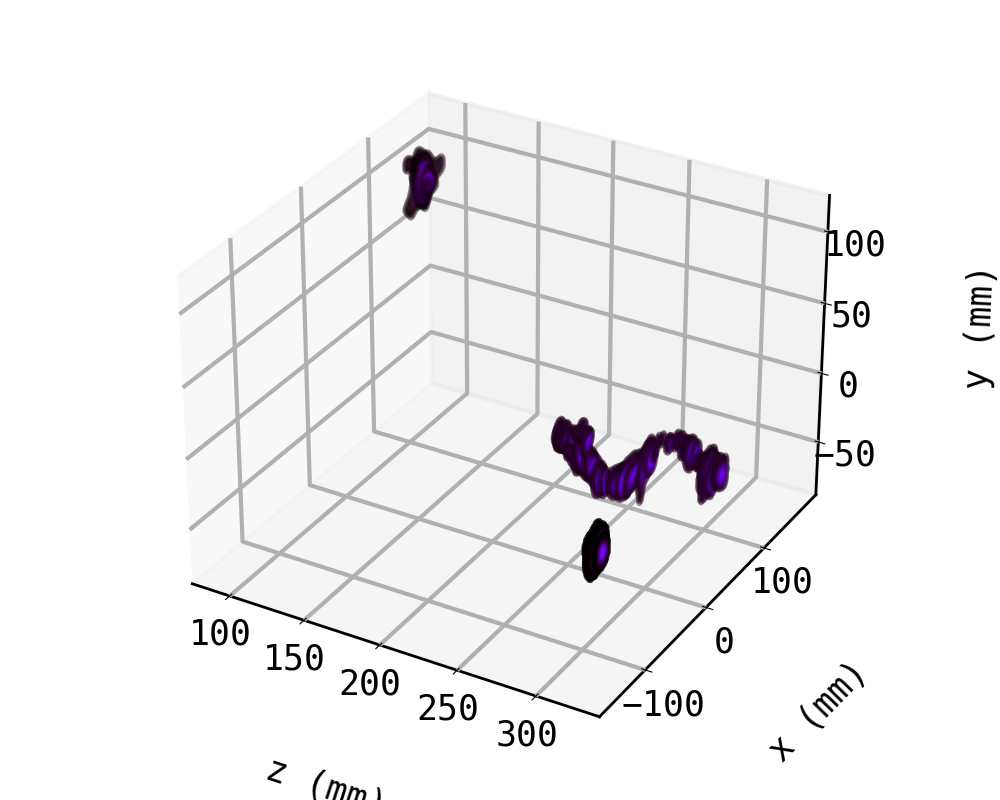

In [14]:
%matplotlib notebook
event = dhits.event.unique()[0]
hits  = dhits .loc[lambda df: (df.event == event)]

plt.ion()

ax = plt.figure(figsize=(10,8)).add_subplot(projection='3d')
ax.scatter(hits.Z, hits.X, hits.Y, c=hits.E, s=0.1)
ax.set_xlabel("z (mm)", labelpad=50)
ax.set_ylabel("x (mm)", labelpad=50)
ax.set_zlabel("y (mm)", labelpad=50)
plt.show()

<IPython.core.display.Javascript object>


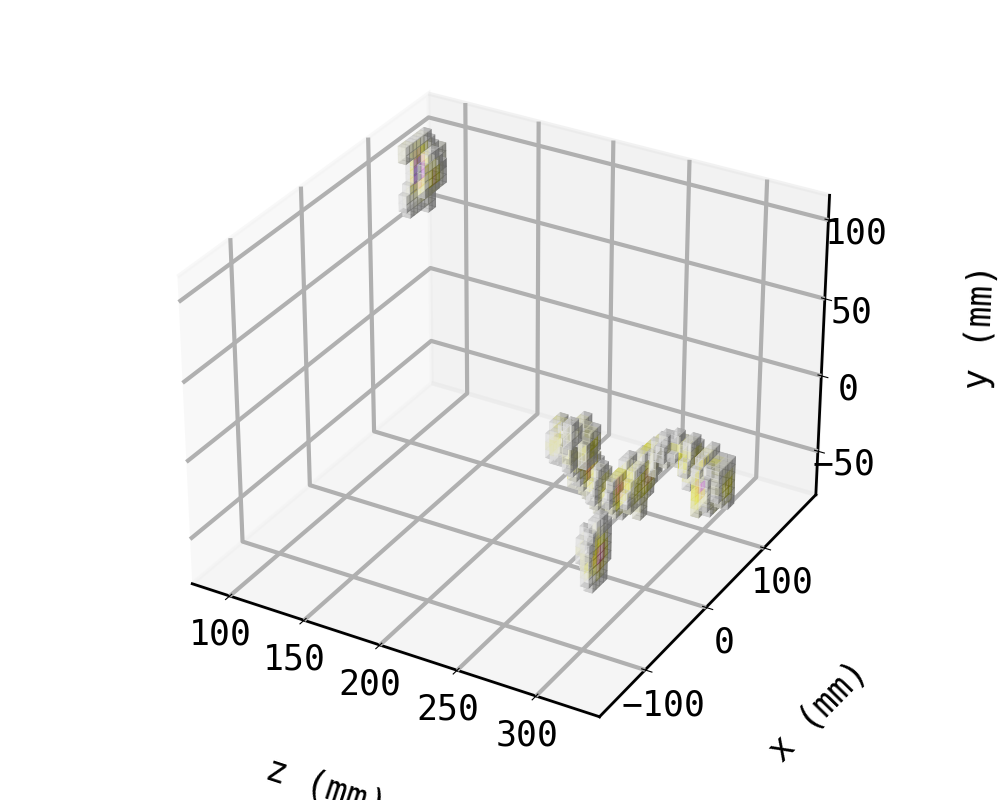

In [15]:
%matplotlib notebook
event = dhits.event.unique()[0]
hits  = dhits .loc[lambda df: (df.event == event)]
plot_hits_voxelized(hits)


# Notes